<a href="https://colab.research.google.com/github/cscampana/COGS118B--FinalProject-Deeplesion/blob/main/cogs118b_project_eda_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Imports

#Plotting tools
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl
import matplotlib.pyplot as plt
from decimal import Decimal
import itertools


# Sci-kit learn 
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN,AgglomerativeClustering
from sklearn.neighbors import kneighbors_graph
from sklearn import manifold, mixture
from sklearn.preprocessing import normalize, MinMaxScaler, StandardScaler
from sklearn.metrics import f1_score

#Keras (for autoencoder)
import keras
from keras.layers import Activation, Dense

from scipy import linalg

#Google drive (Data input)
from google.colab import drive
drive.mount('/content/drive')

%matplotlib inline 

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Exploratory Data Analysis

In [ ]:
# Data Input
data = pd.read_csv('drive/MyDrive/COGS 118B - Project/data_v1_2021.csv')

In [ ]:
# Data Description
data.describe()
data.info()
data.shape
data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32735 entries, 0 to 32734
Data columns (total 18 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   File_name                   32735 non-null  object 
 1   Patient_index               32735 non-null  int64  
 2   Study_index                 32735 non-null  int64  
 3   Series_ID                   32735 non-null  int64  
 4   Key_slice_index             32735 non-null  int64  
 5   Measurement_coordinates     32735 non-null  object 
 6   Bounding_boxes              32735 non-null  object 
 7   Lesion_diameters_Pixel_     32735 non-null  object 
 8   Normalized_lesion_location  32735 non-null  object 
 9   Coarse_lesion_type          32735 non-null  int64  
 10  Possibly_noisy              32735 non-null  int64  
 11  Slice_range                 32735 non-null  object 
 12  Spacing_mm_px_              32735 non-null  object 
 13  Image_size                  327

,File_name,Patient_index,Study_index,Series_ID,Key_slice_index,Measurement_coordinates,Bounding_boxes,Lesion_diameters_Pixel_,Normalized_lesion_location,Coarse_lesion_type,Possibly_noisy,Slice_range,Spacing_mm_px_,Image_size,DICOM_windows,Patient_gender,Patient_age,Train_Val_Test
0,000001_01_01_109.png,1,1,1,109,"233.537, 95.0204, 234.057, 106.977, 231.169, 1...","226.169, 90.0204, 241.252, 111.977","11.9677, 5.10387","0.44666, 0.283794, 0.434454",3,0,"103, 115","0.488281, 0.488281, 5","512, 512","-175, 275",F,62.0,3
1,000001_02_01_014.png,1,2,1,14,"224.826, 289.296, 224.016, 305.294, 222.396, 2...","217.396, 284.296, 233.978, 310.294","16.019, 6.61971","0.431015, 0.485238, 0.340745",3,0,"8, 23","0.314453, 0.314453, 5","512, 512","-175, 275",F,72.0,3
2,000001_02_01_017.png,1,2,1,17,"272.323, 320.763, 246.522, 263.371, 234.412, 3...","229.412, 258.371, 285.221, 325.763","62.9245, 48.9929","0.492691, 0.503106, 0.351754",3,0,"8, 23","0.314453, 0.314453, 5","512, 512","-175, 275",F,72.0,3
3,000001_03_01_088.png,1,3,1,88,"257.759, 157.618, 260.018, 133.524, 251.735, 1...","246.735, 128.524, 270.288, 162.618","24.1998, 13.6123","0.498999, 0.278924, 0.452792",3,0,"58, 118","0.732422, 0.732422, 1","512, 512","-175, 275",F,73.0,3
4,000001_04_01_017.png,1,4,1,17,"304.019, 230.585, 292.217, 211.789, 304.456, 2...","287.217, 206.789, 309.456, 235.585","22.1937, 9.8065","0.572678, 0.42336, 0.445674",3,0,"11, 23","0.666016, 0.666016, 5","512, 512","-175, 275",F,73.0,3


In [ ]:
# Select anyone over 95 years old
data[data['Patient_age'] > 95]

##Drop row with person age 157
data = data.drop(labels=[29833],axis=0)

# Separate test data
unknowndata = data[data.Coarse_lesion_type == -1]
data = data[data.Coarse_lesion_type != -1]

# Reset the index of both the data, and the test data.
data.reset_index(inplace=True)
unknowndata.reset_index(inplace=True)

# Check the shape of the data
data.shape[0]

# Check the distribution between genders in the data
data['Patient_gender'].value_counts()

M    5720
F    4096
Name: Patient_gender, dtype: int64

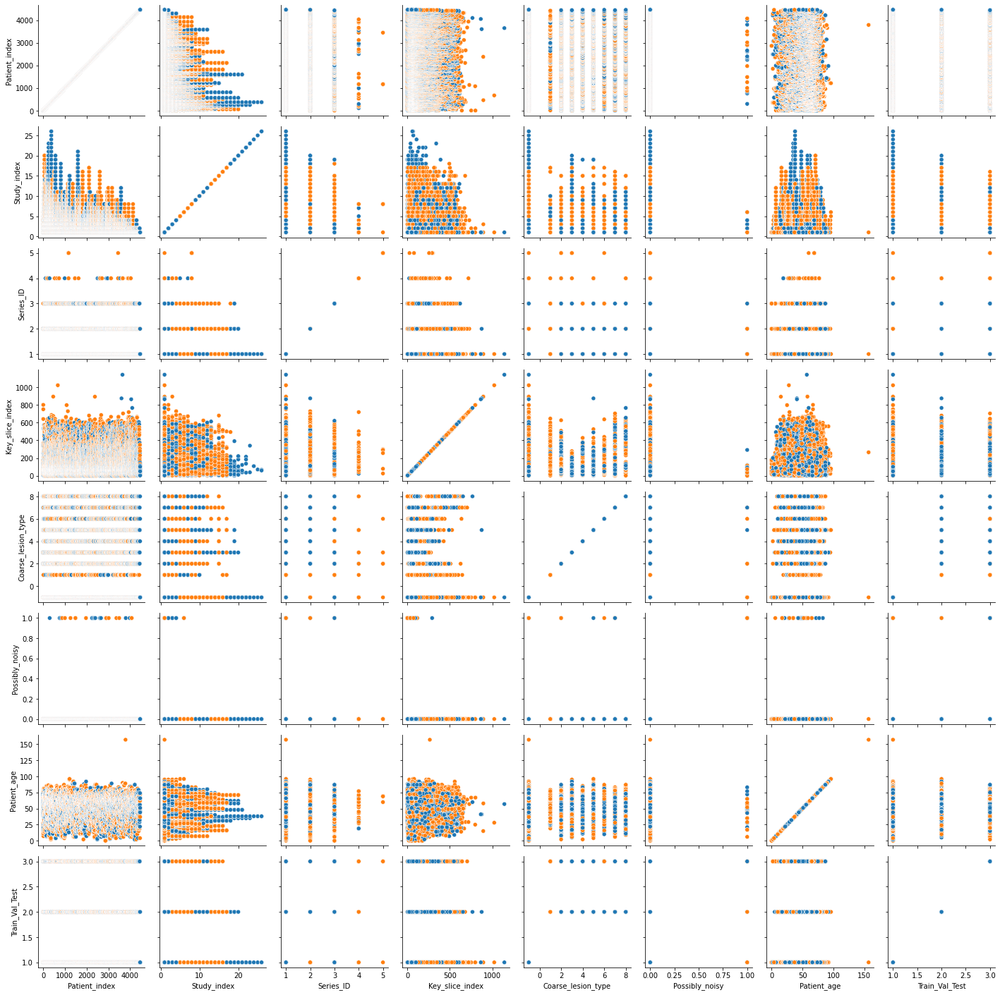

In [ ]:
g = sns.PairGrid(data, hue='Patient_gender', palette="tab10")
sns.set_style("darkgrid")
g.map(sns.scatterplot)

use 'unknowndata' for data that is unlabeled

In [ ]:
  coltype = []
  for y in range(0,len(data['Coarse_lesion_type'])):
    if data['Coarse_lesion_type'][y] == 3:
      coltype.append('red')
    elif data['Coarse_lesion_type'][y] == 2:
      coltype.append('blue')
    elif data['Coarse_lesion_type'][y] == -1:
      coltype.append('w')
    elif data['Coarse_lesion_type'][y] == 7:
      coltype.append('cyan')
    elif data['Coarse_lesion_type'][y] == 5:
      coltype.append('yellow')
    elif data['Coarse_lesion_type'][y] == 6:
      coltype.append('darkgreen')
    elif data['Coarse_lesion_type'][y] == 1:
      coltype.append('hotpink')
    elif data['Coarse_lesion_type'][y] == 8:
      coltype.append('darkorchid')
    elif data['Coarse_lesion_type'][y] == 4:
      coltype.append('black')

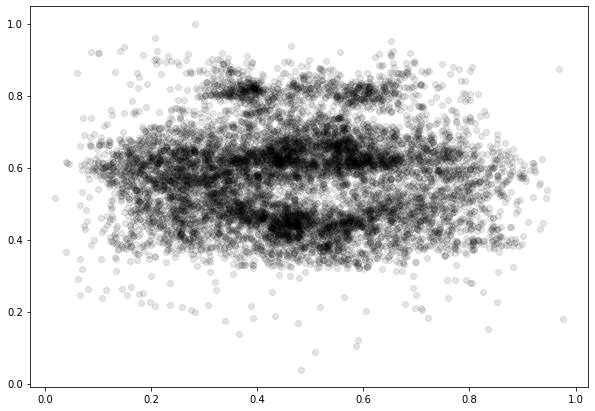

In [ ]:
N=32734
colors = np.random.rand(N)
plt.gcf().set_size_inches((10, 7))  
plt.scatter(data_coord['nll_1'], data_coord['nll3'],c='black',alpha=0.1)

In [ ]:
data['Coarse_lesion_type'].unique()

array([3, 2, 7, 5, 6, 1, 8, 4])

In [ ]:
colors

array([0.76533643, 0.88837748, 0.46994636, ..., 0.74765207, 0.57748467,
       0.1285968 ])

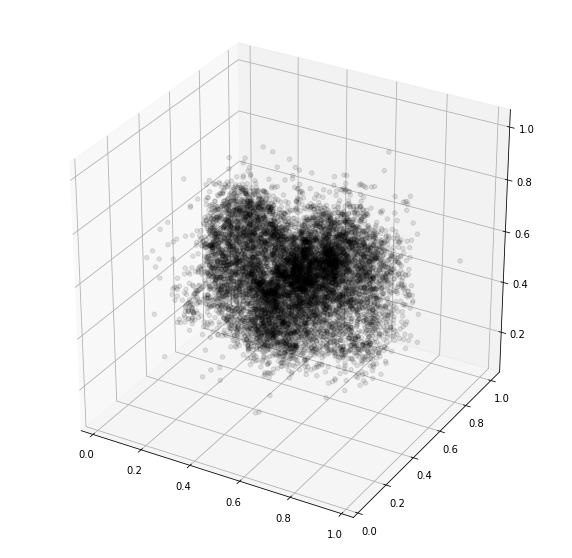

In [ ]:
##scatterplot of data using all three dimensions
fig = plt.figure()
plt.gcf().set_size_inches((10,10))   
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data_coord['nll_1'], data_coord['nll3'], data_coord['nll2'], zdir='z', s=20, c='black', alpha=0.1)

#### Dataframe with 'Measurement_coordinates', 'Bounding_boxes',  'normalized lesion location', and 'Coarse_lesion_type' parsed using Pandas trick





In [ ]:
bounding_boxes = []
for r  in range(data['Bounding_boxes'].size):
    bounding_boxes.append(list(np.float_(data['Bounding_boxes'].values[r].split(', '))))
measurement_coordinates = []
for r  in range(data['Measurement_coordinates'].size):
    measurement_coordinates.append(list(np.float_(data['Measurement_coordinates'].values[r].split(', '))))
normalized_lesion_location = []
for r  in range(data['Normalized_lesion_location'].size):
    normalized_lesion_location.append(list(np.float_(data['Normalized_lesion_location'].values[r].split(', '))))
Lesion_Diameter = []
for r  in range(data['Lesion_diameters_Pixel_'].size):
    Lesion_Diameter.append(list(np.float_(data['Lesion_diameters_Pixel_'].values[r].split(', '))))

data_bb = pd.DataFrame(data=bounding_boxes, columns=["bb_1","bb_2","bb_3","bb_4"])
data_ms = pd.DataFrame(data=measurement_coordinates, columns=["mc_1","mc_2","mc_3","mc_4","mc_5","mc_6","mc_7","mc_8"])
data_nll = pd.DataFrame(data=normalized_lesion_location, columns=["nll_1","nll2","nll3"])
data_ldp = pd.DataFrame(data=Lesion_Diameter,columns=["d_1","d_2"])
data_coord = pd.DataFrame(data_bb)
data_coord = data_coord.join([data_ldp,data_ms,data_nll,data['Coarse_lesion_type']])


,bb_1,bb_2,bb_3,bb_4,d_1,d_2,mc_1,mc_2,mc_3,mc_4,mc_5,mc_6,mc_7,mc_8,nll_1,nll2,nll3,Coarse_lesion_type
0,226.1690,90.0204,241.2520,111.977,11.9677,5.10387,233.5370,95.0204,234.057,106.977,231.1690,101.605,236.2520,101.143,0.446660,0.283794,0.434454,3
1,217.3960,284.2960,233.9780,310.294,16.0190,6.61971,224.8260,289.2960,224.016,305.294,222.3960,297.194,228.9780,297.903,0.431015,0.485238,0.340745,3
2,229.4120,258.3710,285.2210,325.763,62.9245,48.99290,272.3230,320.7630,246.522,263.371,234.4120,305.494,280.2210,288.118,0.492691,0.503106,0.351754,3
3,246.7350,128.5240,270.2880,162.618,24.1998,13.61230,257.7590,157.6180,260.018,133.524,251.7350,145.571,265.2880,146.841,0.498999,0.278924,0.452792,3
4,287.2170,206.7890,309.4560,235.585,22.1937,9.80650,304.0190,230.5850,292.217,211.789,304.4560,218.783,296.1510,223.998,0.572678,0.423360,0.445674,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9811,245.4070,268.3740,276.5360,297.666,25.7396,16.78670,271.5360,292.6660,250.407,277.967,265.1060,273.374,255.5190,287.154,0.509936,0.502679,0.462449,3
9812,195.5460,165.2940,226.2910,200.360,25.1254,20.79350,208.3250,195.3600,206.597,170.294,221.2910,184.005,200.5460,185.435,0.378383,0.291022,0.890591,7
9813,231.7940,289.4720,293.2360,340.002,52.1203,41.06450,288.2360,307.5270,236.794,315.906,252.1870,294.472,258.7890,335.002,0.473676,0.639494,0.815814,8
9814,157.1840,311.6100,192.7840,348.035,32.8874,32.88740,182.8290,316.6100,162.184,342.210,187.7840,343.035,162.1840,322.390,0.330862,0.644310,0.628514,4


In [ ]:
bounding_boxes = []
measurement_coordinates = []
normalized_lesion_location = []
Lesion_Diameter = []
for r  in range(data['Bounding_boxes'].size):
    bounding_boxes.append(list(np.float_(data['Bounding_boxes'].values[r].split(', '))))
    measurement_coordinates.append(list(np.float_(data['Measurement_coordinates'].values[r].split(', '))))
    normalized_lesion_location.append(list(np.float_(data['Normalized_lesion_location'].values[r].split(', '))))
    Lesion_Diameter.append(list(np.float_(data['Lesion_diameters_Pixel_'].values[r].split(', '))))

data_bb = pd.DataFrame(data=bounding_boxes, columns=["bb_1","bb_2","bb_3","bb_4"])
data_ms = pd.DataFrame(data=measurement_coordinates, columns=["mc_1","mc_2","mc_3","mc_4","mc_5","mc_6","mc_7","mc_8"])
data_nll = pd.DataFrame(data=normalized_lesion_location, columns=["nll_1","nll2","nll3"])
data_ldp = pd.DataFrame(data=Lesion_Diameter,columns=["d_1","d_2"])
data_coord = pd.DataFrame(data_bb)
data_coord = data_coord.join([data_ldp,data_ms,data_nll,data['Coarse_lesion_type']])
data_coord

,bb_1,bb_2,bb_3,bb_4,d_1,d_2,mc_1,mc_2,mc_3,mc_4,mc_5,mc_6,mc_7,mc_8,nll_1,nll2,nll3,Coarse_lesion_type
0,226.1690,90.0204,241.2520,111.977,11.9677,5.10387,233.5370,95.0204,234.057,106.977,231.1690,101.605,236.2520,101.143,0.446660,0.283794,0.434454,3
1,217.3960,284.2960,233.9780,310.294,16.0190,6.61971,224.8260,289.2960,224.016,305.294,222.3960,297.194,228.9780,297.903,0.431015,0.485238,0.340745,3
2,229.4120,258.3710,285.2210,325.763,62.9245,48.99290,272.3230,320.7630,246.522,263.371,234.4120,305.494,280.2210,288.118,0.492691,0.503106,0.351754,3
3,246.7350,128.5240,270.2880,162.618,24.1998,13.61230,257.7590,157.6180,260.018,133.524,251.7350,145.571,265.2880,146.841,0.498999,0.278924,0.452792,3
4,287.2170,206.7890,309.4560,235.585,22.1937,9.80650,304.0190,230.5850,292.217,211.789,304.4560,218.783,296.1510,223.998,0.572678,0.423360,0.445674,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9811,245.4070,268.3740,276.5360,297.666,25.7396,16.78670,271.5360,292.6660,250.407,277.967,265.1060,273.374,255.5190,287.154,0.509936,0.502679,0.462449,3
9812,195.5460,165.2940,226.2910,200.360,25.1254,20.79350,208.3250,195.3600,206.597,170.294,221.2910,184.005,200.5460,185.435,0.378383,0.291022,0.890591,7
9813,231.7940,289.4720,293.2360,340.002,52.1203,41.06450,288.2360,307.5270,236.794,315.906,252.1870,294.472,258.7890,335.002,0.473676,0.639494,0.815814,8
9814,157.1840,311.6100,192.7840,348.035,32.8874,32.88740,182.8290,316.6100,162.184,342.210,187.7840,343.035,162.1840,322.390,0.330862,0.644310,0.628514,4


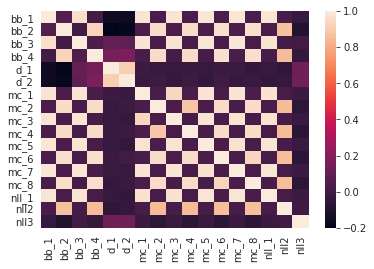

In [ ]:
sns.heatmap(data_coord.corr());

In [ ]:
from sklearn.preprocessing import StandardScaler
def normc(Mat):
  return normalize(Mat,norm='l2',axis=0)
size = []
for i in range(0,len(data_coord['d_1'])):
  size.append(3.14159*data_coord['d_1'][i]*data_coord['d_2'][i])
size = normc(np.asarray(size).reshape(-1,1))
data_s = pd.DataFrame(data=size,columns=["size"])
data_coord = data_coord.join([data_s])

In [ ]:
## normalize the data
X_scaled = data_coord.drop(['nll_1','nll2','nll3','Coarse_lesion_type','size'],axis=1)
X_scaled = StandardScaler().fit_transform(X_scaled)

In [ ]:
g = pd.DataFrame(X_scaled).join([data_coord['nll_1'],data_coord['nll2'],data_coord['nll3']])

### TSNE

In [ ]:
data_test_tsne = data_coord.copy()

res_tsne = TSNE(n_components=3, verbose=1, perplexity=2000).fit_transform(np.array(data_test_tsne))
data_test_tsne['tsne-result-one'] = res_tsne[:,0]
data_test_tsne['tsne-result-two'] = res_tsne[:,1]
data_test_tsne['tsne-result-three'] = res_tsne[:,2]

[t-SNE] Computing 6001 nearest neighbors...
[t-SNE] Indexed 9816 samples in 0.000s...
[t-SNE] Computed neighbors for 9816 samples in 9.236s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9816
[t-SNE] Computed conditional probabilities for sample 2000 / 9816
[t-SNE] Computed conditional probabilities for sample 3000 / 9816
[t-SNE] Computed conditional probabilities for sample 4000 / 9816
[t-SNE] Computed conditional probabilities for sample 5000 / 9816
[t-SNE] Computed conditional probabilities for sample 6000 / 9816
[t-SNE] Computed conditional probabilities for sample 7000 / 9816
[t-SNE] Computed conditional probabilities for sample 8000 / 9816
[t-SNE] Computed conditional probabilities for sample 9000 / 9816
[t-SNE] Computed conditional probabilities for sample 9816 / 9816
[t-SNE] Mean sigma: 17.460063


KeyboardInterrupt: ignored

In [ ]:

fig = px.scatter_3d(data_test_tsne,x='tsne-result-one',y='tsne-result-two',z='tsne-result-three', color = 'Coarse_lesion_type')
fig.show()

In [ ]:
g = sns.PairGrid(data_coord, hue='Coarse_lesion_type', palette="tab10")
sns.set_style("darkgrid")
g.map(sns.scatterplot)

PCA testing for the data set
Using all the features we found that PCA is best executed, when 2 components are used, which retains 95% of the variance.
Using bounding boxes we found that PCA is best executed, when 2 components are used, which retains 98% of the variance.
Using measurement coordinates we found that PCA is best executed, when 2 components are used, which retains 97% of the variance.
Using normalized leasion location we found that PCA is best executed, when 3 components are used, which retains 100% of the variance.
Using diameter measurements we found that PCA is best executed, when 1 components are used, which retains 96% of the variance.
The best method is using the feature normalized leasion location, where it retained 100% of the variance


,All_1,All_2,bb_1,bb_2,mc_1,mc_2,nll_1,nll_2,nll_3,dd
0,-47.422929,-381.415764,-27.519645,-220.401560,-38.753565,-311.439546,-0.028854,-0.214876,0.146609,-24.536394
1,-48.716891,99.722266,-27.576545,57.420273,-40.284738,81.418898,-0.033271,-0.010881,0.235897,-20.333592
2,30.732710,86.792061,16.652110,48.011640,26.099263,72.603371,0.028893,0.003890,0.223176,42.278120
3,17.884520,-274.741270,10.046886,-158.892902,14.749062,-224.185856,0.022792,-0.222549,0.127291,-9.637018
4,123.927491,-93.962449,70.684301,-54.329705,101.721988,-76.727070,0.103085,-0.081520,0.129479,-13.435359


### GMM 

##### Function to plot the all the variations of the Gaussian mixture models.

In [ ]:
def plot_results(data):
    fig, axs = plt.subplots(4,2)
    fig.set_size_inches(20, 20)
    types = ['spherical','tied','diag','full']
    for i in range(len(types)):
        gmm = mixture.GaussianMixture(n_components=7, covariance_type=types[i],n_init=10).fit(data)
        labels_gmm = gmm.predict(data)
        axs[i,0].scatter(data[:, 0], data[:, 1], c=labels_gmm, s=70, cmap='viridis');
        axs[i,0].set_title("GMM" + " " + types[i])
        bayesian = mixture.BayesianGaussianMixture(n_components=7, covariance_type=types[i],n_init=10, max_iter = 1000).fit(data)
        labels_bayesian = bayesian.predict(data)
        axs[i,1].scatter(data[:, 0], data[:, 1], c=labels_bayesian, s=70, cmap='viridis');
        axs[i,1].set_title("Bayesian" + " " + types[i])
    plt.show()

def plot_results1D(data,name):
    fig, axs = plt.subplots(4,2)
    fig.set_size_inches(20, 20)
    types = ['spherical','tied','diag','full']
    for i in range(len(types)):
        gmm = mixture.GaussianMixture(n_components=7, covariance_type=types[i],n_init=10).fit(data)
        labels_gmm = gmm.predict(data)
        axs[i,0].scatter(data[:, 0], data[:, 0], c=labels_gmm, s=70, cmap='viridis');
        axs[i,0].set_title("GMM" + " " + types[i])
        bayesian = mixture.BayesianGaussianMixture(n_components=7, covariance_type=types[i],n_init=10, max_iter = 1000).fit(data)
        labels_bayesian = bayesian.predict(data)
        axs[i,1].scatter(data[:, 0], data[:, 0], c=labels_bayesian, s=70, cmap='viridis');
        axs[i,1].set_title("Bayesian" + " " + types[i])
    plt.show()

#### Normalized Leasion Location

In [ ]:
nll_gmm = np.array(data_pca['Measurement coordinates'])
plot_results(data_pca['Measurement coordinates'])


ValueError: ignored

#### Bounding_boxes

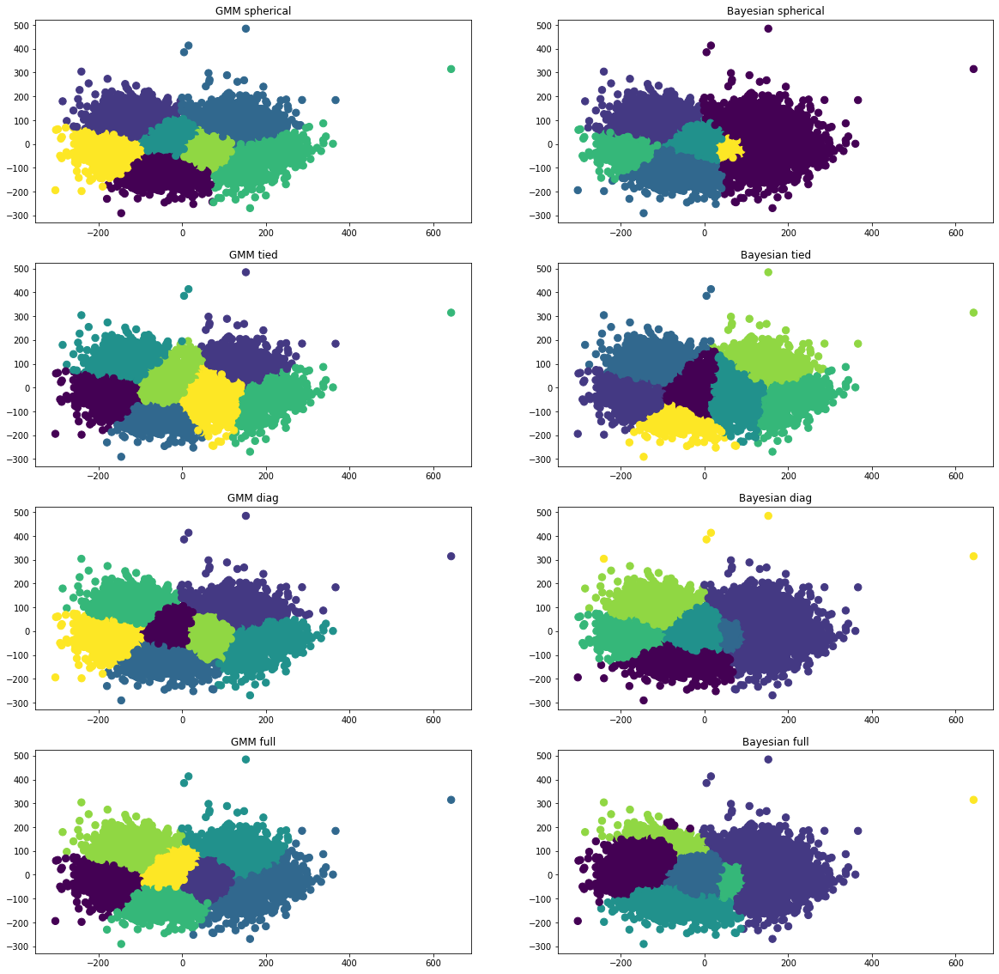

In [ ]:
bb_gmm = np.array(data_pca[['bb_1','bb_2']])
plot_results(bb_gmm)

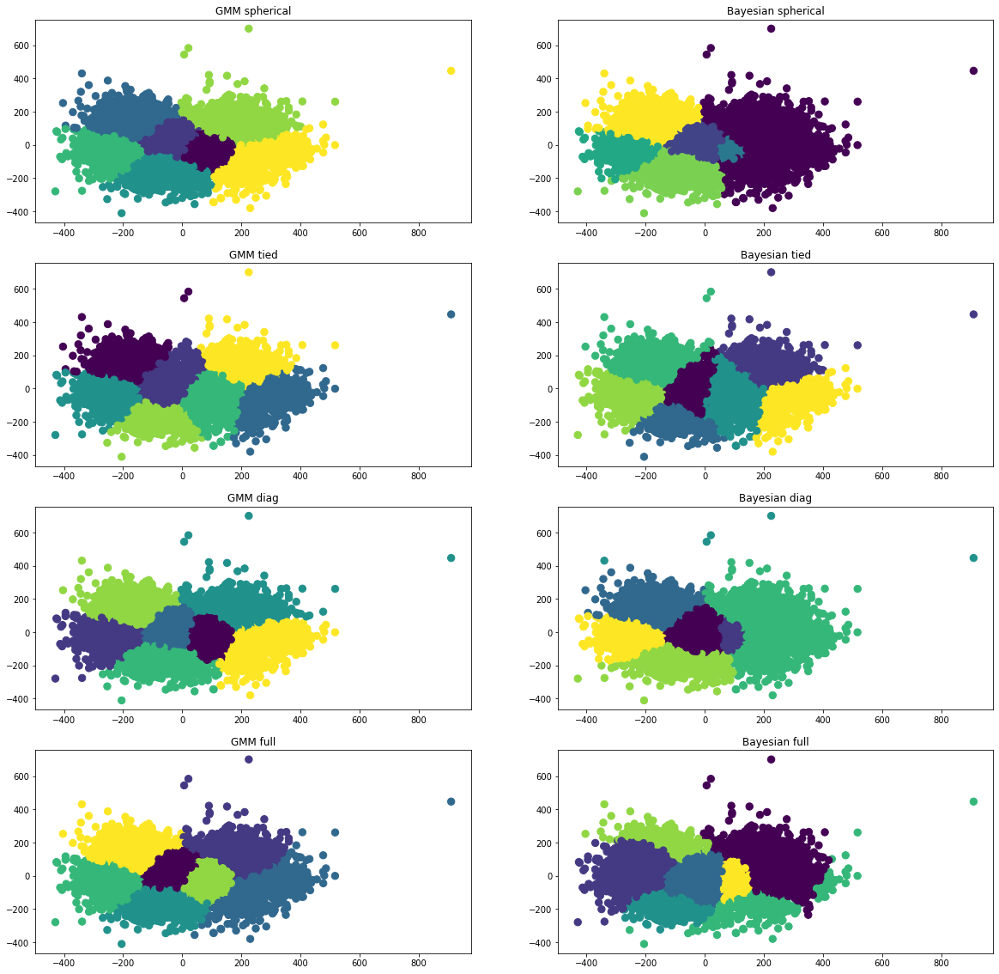

In [ ]:
ms_gmm = np.array(data_pca[['mc_1','mc_2']])
plot_results(ms_gmm)

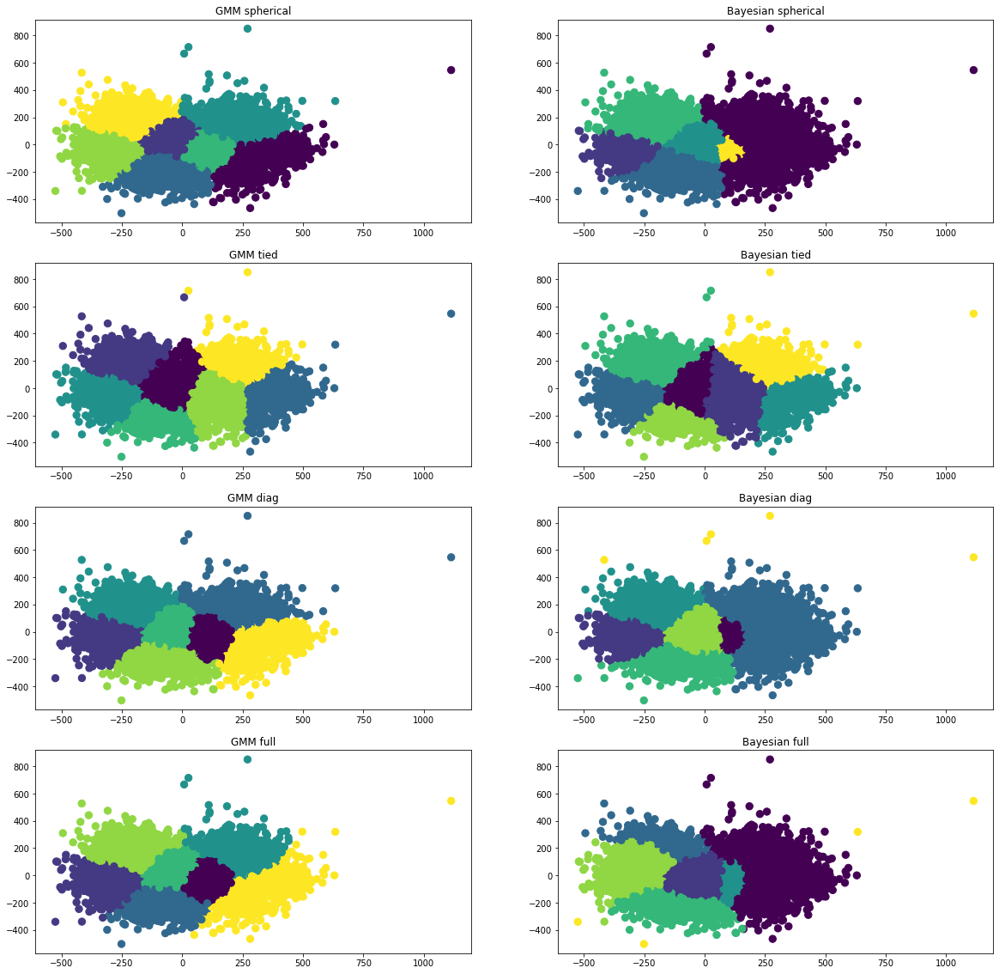

In [ ]:
all_gmm = np.array(data_pca[['All_1','All_2']])
plot_results(all_gmm)

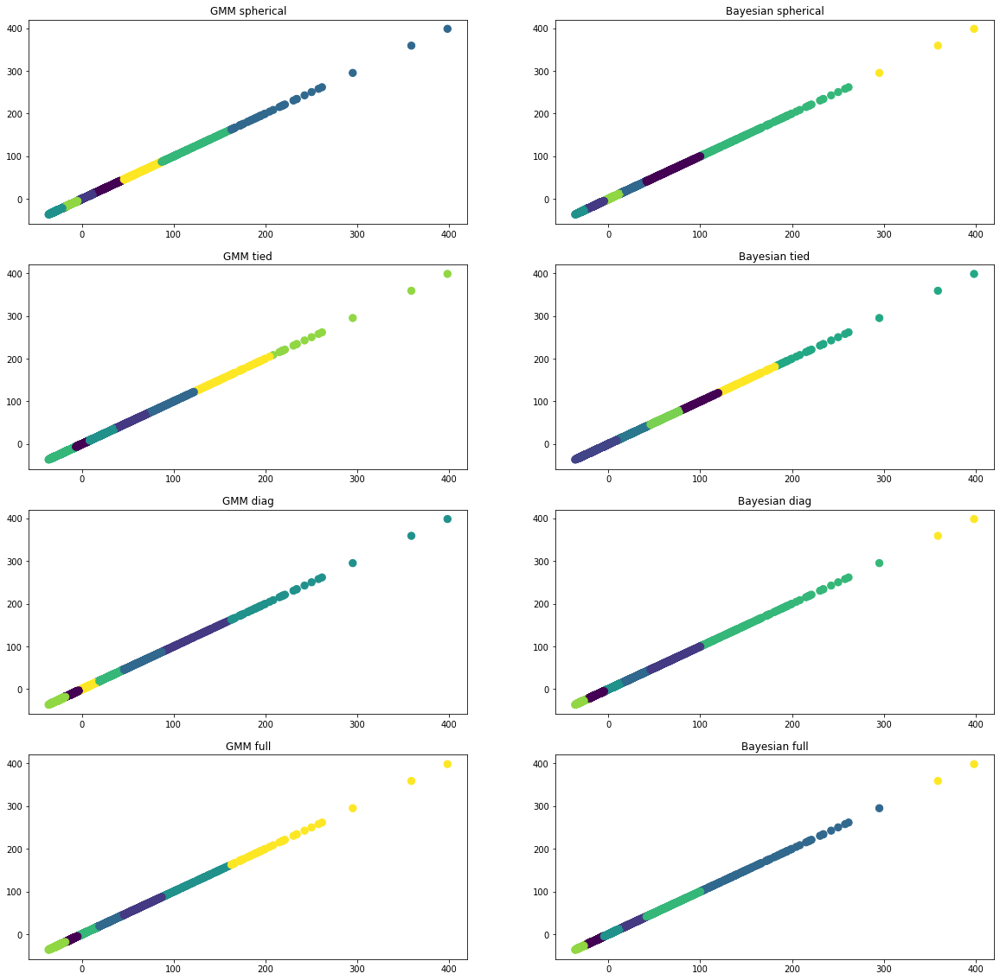

In [ ]:
diameter_gmm =  np.array(data_pca[['dd']])
plot_results1D(diameter_gmm)

### K-Means

In [ ]:
data['Normalized_lesion_location'] = data['Normalized_lesion_location'].str.replace(",","")
lesionloc = data[['Normalized_lesion_location']]
lesionloc = lesionloc.Normalized_lesion_location.str.split(expand=True,)

In [ ]:
#Save lesionloc as txt file
np_array = lesionloc.to_numpy()
np.savetxt("lesionloc.txt", np_array, fmt = "%s")

In [ ]:
#Code provided in HW 2
def plotCurrent(X, Rnk, Kmus):
    N, D = np.shape(X)
    K = np.shape(Kmus)[0]

    InitColorMat = np.matrix([[1, 0, 0], 
                              [0, 1, 0],   
                              [0, 0, 1],
                              [0, 0, 0],
                              [1, 1, 0], 
                              [1, 0, 1], 
                              [0, 1, 1]])

    KColorMat = InitColorMat[0:K]
    colorVec = Rnk.dot(KColorMat)
    muColorVec = np.eye(K).dot(KColorMat)

    plt.scatter(X[:,0], X[:,1], edgecolors=colorVec, marker='o', facecolors='none', alpha=0.3)
    plt.scatter(Kmus[:,0], Kmus[:,1], c=muColorVec, marker='D', s=50);

In [ ]:
def calcSqDistances(X, Kmus):
    sqDmat = [ [ 0 for i in range(len(Kmus)) ] for j in range(len(X)) ]
    for i in range(len(X)):
        for j in range(len(Kmus)):
            sqDmat[i][j] = np.sum((np.power((Kmus[j] - X[i]),2)))
    sqDmat = np.array(sqDmat)
    return sqDmat

In [ ]:
def determineRnk(sqDmat):
    R = [ [ 0 for i in range(len(sqDmat[0]))]for j in range(len(sqDmat))]
    for i in range(len(sqDmat)):
        for j in range(len(sqDmat[0])):
            if sqDmat[i][j]== min(sqDmat[i]):
                R[i][j] = 1
            else:
                R[i][j]= 0
    R = np.array(R)
    return R

In [ ]:
def recalcMus(X, Rnk):
    Kmus = []
    total = 0
    count = 0
    
    for j in range(len(Rnk[0])):

        for i in range(len(X)):

        
            if Rnk[i][j] == 1:
                total += np.dot(np.transpose(Rnk[i][j]), X[i])
                count += 1
            
        Kmus.append(total/count)

        total = 0
        count = 0
    Kmus = np.array(Kmus)
    return Kmus


In [ ]:
#Code provided in HW 2
def runKMeans(K, fileString):
    # Load data file specified by fileStringfrom Bishop book
    X = np.loadtxt(fileString)
    
    # Determine and store data set information
    N = np.shape(X)[0]
    D = np.shape(X)[1]

    # Allocate space for the K mu vectors
    Kmus = np.zeros((K, D))

    # Initialize cluster centers by randomly picking points from the data
    rndinds = np.random.permutation(N)
    Kmus = X[rndinds[:K]];

    # Specify the maximum number of iterations to allow
    maxiters = 1000;

    for iter in range(maxiters):
        # Assign each data vector to closest mu vector as per Bishop (9.2)
        # Do this by first calculating a squared distance matrix where the n,k entry
        # contains the squared distance from the nth data vector to the kth mu vector

        # sqDmat will be an N-by-K matrix with the n,k entry as specfied above
        sqDmat = calcSqDistances(X, Kmus);

        # given the matrix of squared distances, determine the closest cluster
        # center for each data vector 

        # R is the "responsibility" matrix
        # R will be an N-by-K matrix of binary values whose n,k entry is set as 
        # per Bishop (9.2)
        # Specifically, the n,k entry is 1 if point n is closest to cluster k,
        # and is 0 otherwise
        Rnk = determineRnk(sqDmat)

        KmusOld = Kmus
        plotCurrent(X, Rnk, Kmus)
        plt.show()

        # Recalculate mu values based on cluster assignments as per Bishop (9.4)
        Kmus = recalcMus(X, Rnk)

        # Check to see if the cluster centers have converged.  If so, break.
        if sum(abs(KmusOld.flatten() - Kmus.flatten())) < 1e-6:
            break

    plotCurrent(X,Rnk,Kmus)

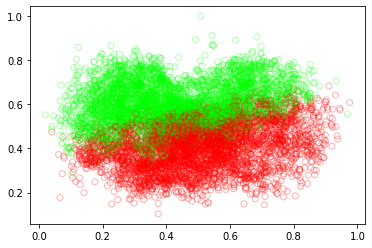

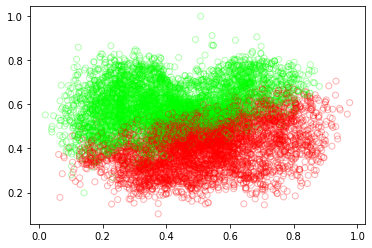

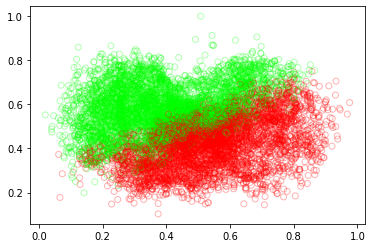

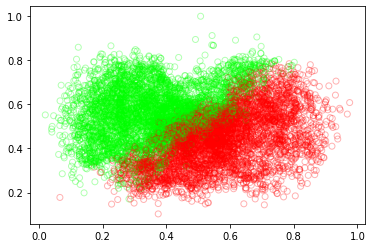

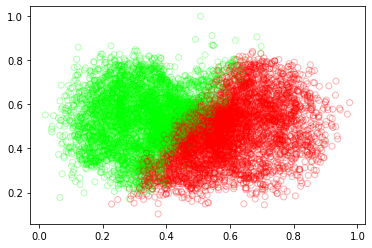

...

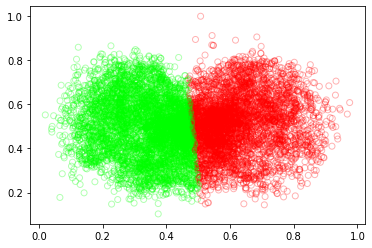

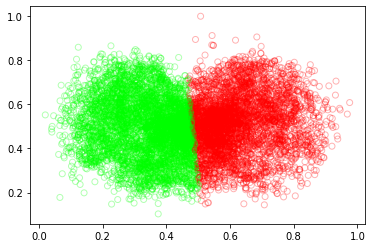

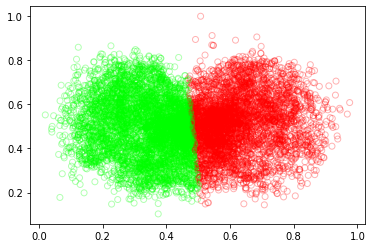

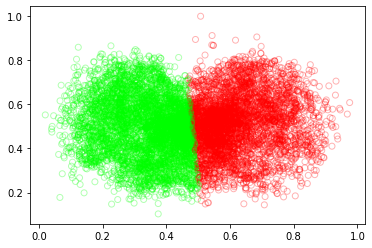

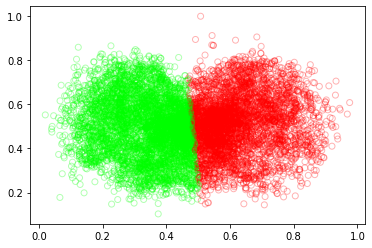

In [ ]:
runKMeans(2, 'lesionloc.txt')

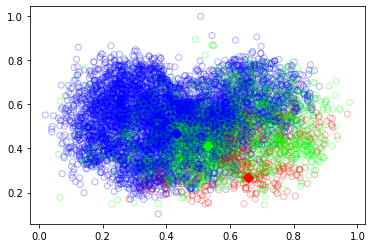

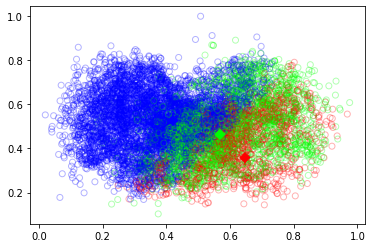

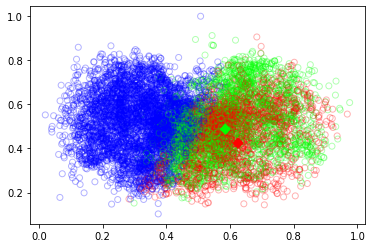

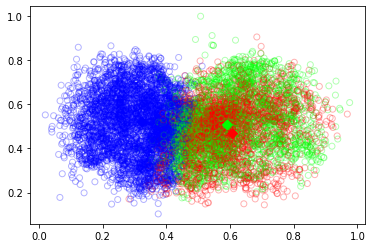

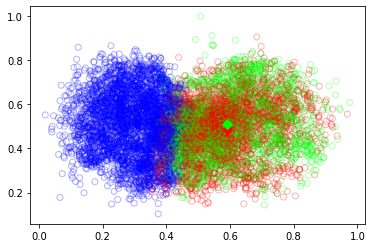

...

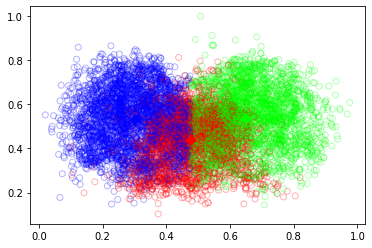

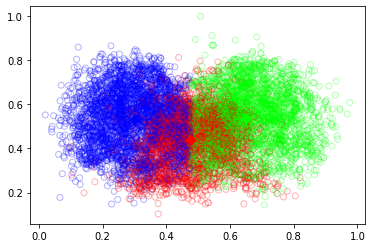

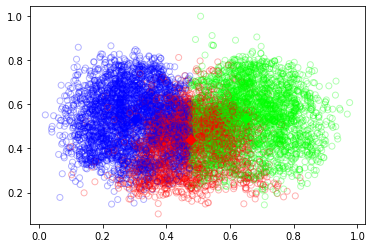

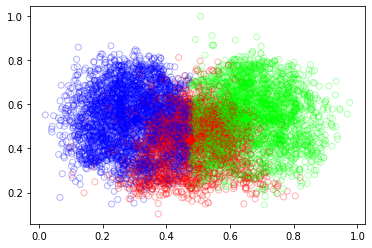

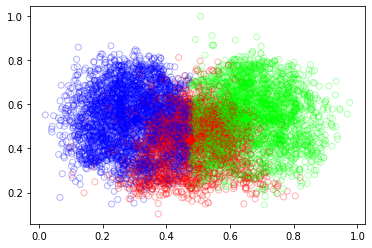

In [ ]:
runKMeans(3, 'lesionloc.txt')

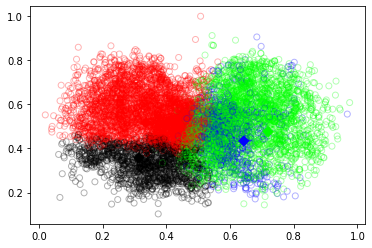

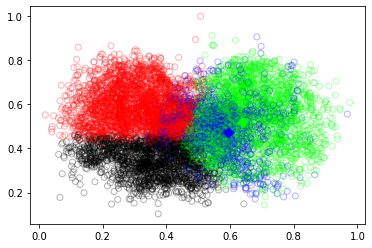

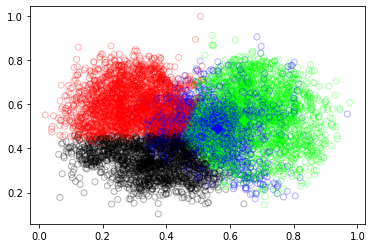

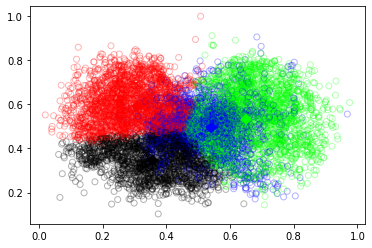

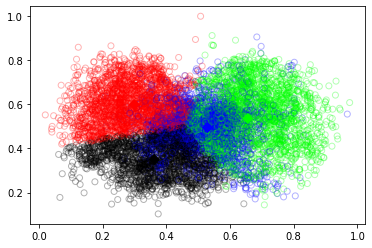

...

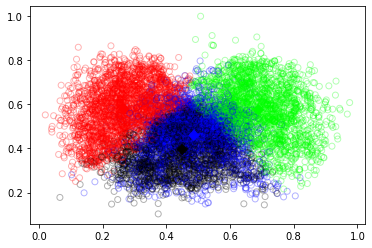

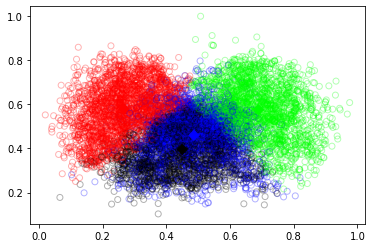

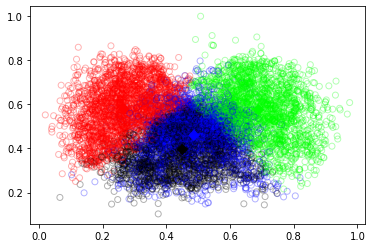

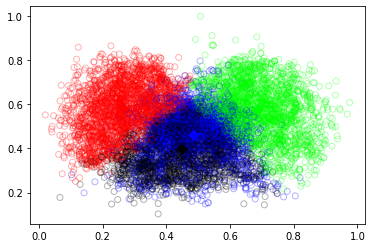

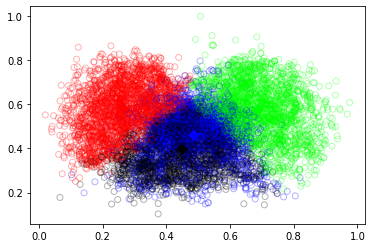

In [ ]:
runKMeans(4, 'lesionloc.txt')

kmeans good at detecting lesions of major organs but tissue lesions are misclassified

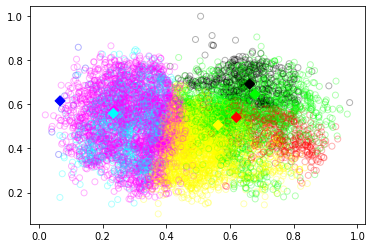

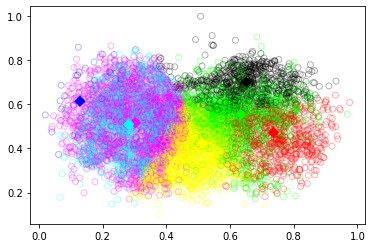

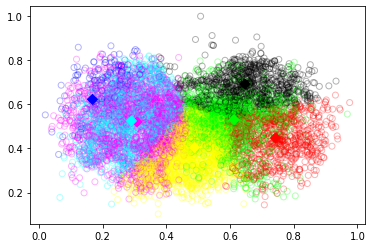

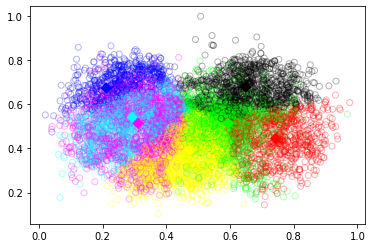

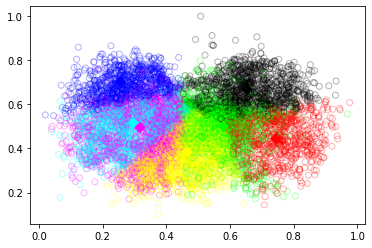

...

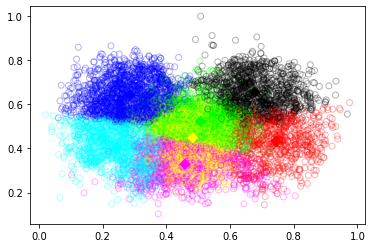

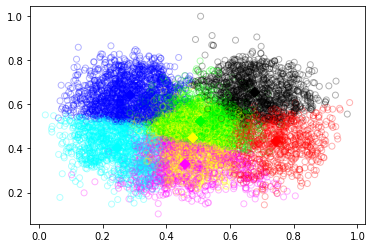

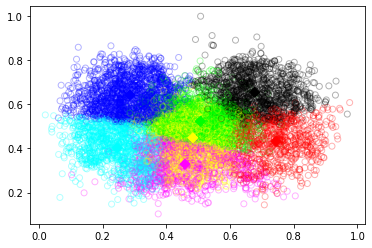

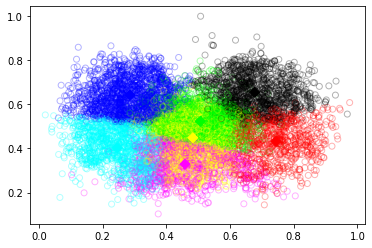

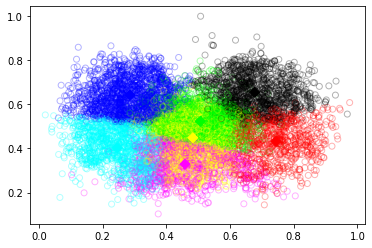

In [ ]:
runKMeans(7, 'lesionloc.txt')

In [ ]:
# Reduce dimensionality of lesionloc.txt to 2D
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(lesionloc)
lesion_loc_pca = pd.DataFrame(data = principalComponents, columns = ['x', 'y'])

In [ ]:
#Save lesion_loc_pca as txt file
np_array = lesion_loc_pca.to_numpy()
np.savetxt("lesion_loc_pca.txt", np_array, fmt = "%s")

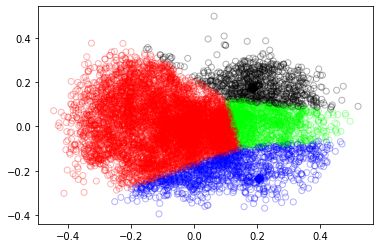

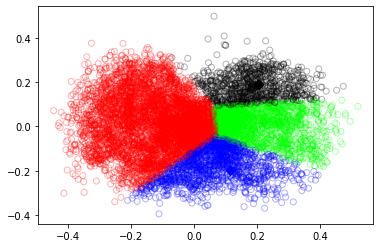

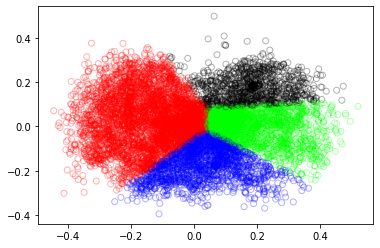

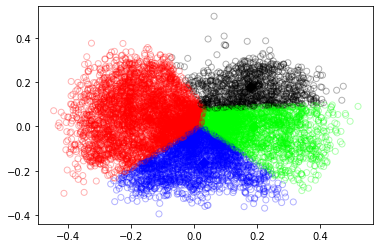

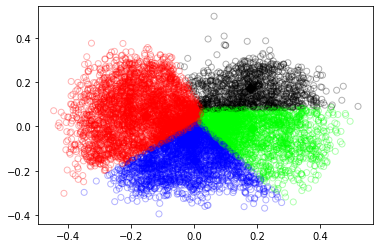

...

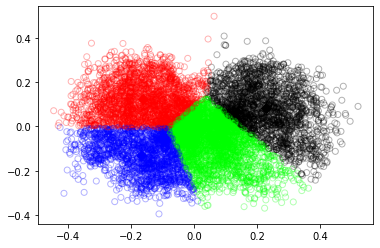

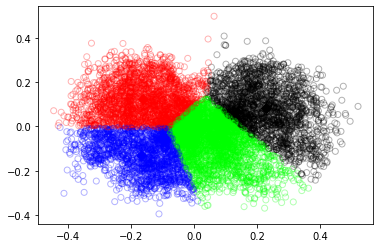

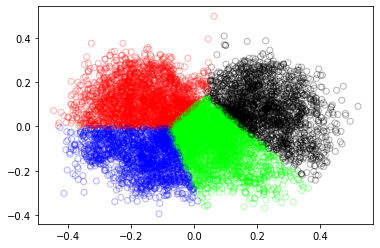

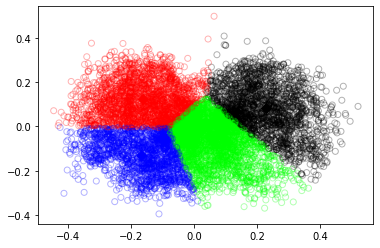

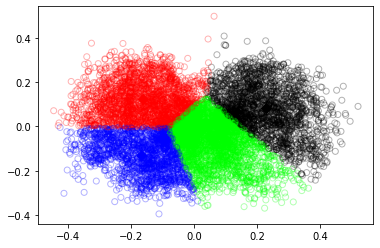

In [ ]:
#Run K-Means on dimensionality reduced normalized_lesion_location
runKMeans(4, 'lesion_loc_pca.txt')

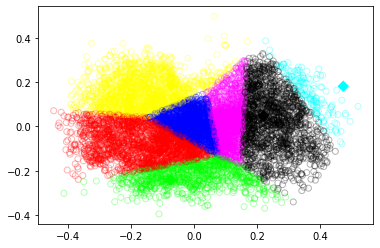

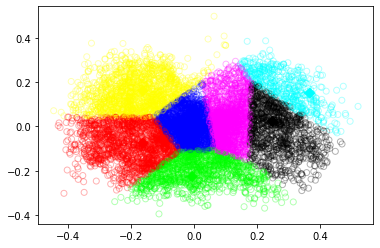

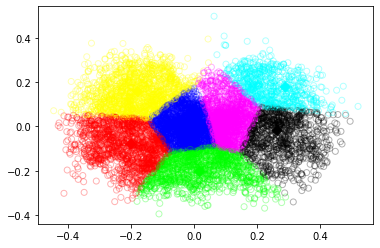

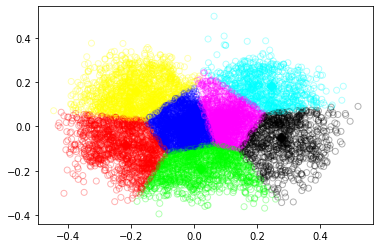

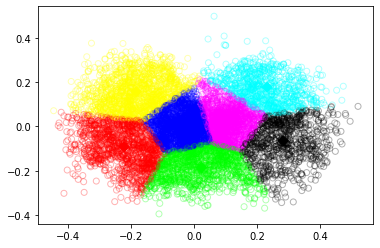

...

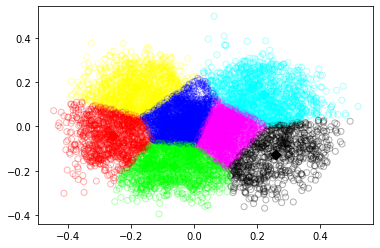

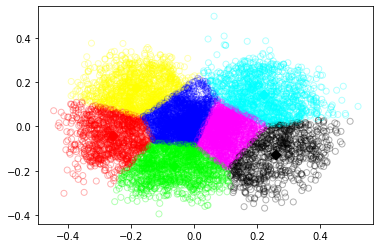

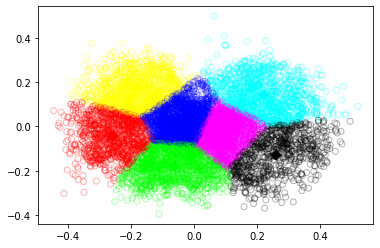

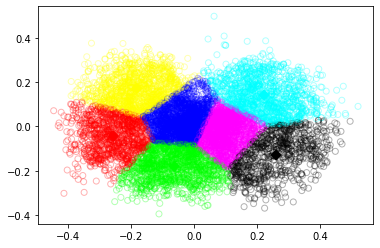

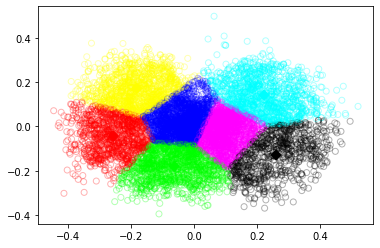

In [ ]:
runKMeans(7, 'lesion_loc_pca.txt')

In [ ]:
data_coord

,bb_1,bb_2,bb_3,bb_4,d_1,d_2,mc_1,mc_2,mc_3,mc_4,mc_5,mc_6,mc_7,mc_8,nll_1,nll2,nll3,Coarse_lesion_type,size
0,226.1690,90.0204,241.2520,111.977,11.9677,5.10387,233.5370,95.0204,234.057,106.977,231.1690,101.605,236.2520,101.143,0.446660,0.283794,0.434454,3,0.000209
1,217.3960,284.2960,233.9780,310.294,16.0190,6.61971,224.8260,289.2960,224.016,305.294,222.3960,297.194,228.9780,297.903,0.431015,0.485238,0.340745,3,0.000363
2,229.4120,258.3710,285.2210,325.763,62.9245,48.99290,272.3230,320.7630,246.522,263.371,234.4120,305.494,280.2210,288.118,0.492691,0.503106,0.351754,3,0.010552
3,246.7350,128.5240,270.2880,162.618,24.1998,13.61230,257.7590,157.6180,260.018,133.524,251.7350,145.571,265.2880,146.841,0.498999,0.278924,0.452792,3,0.001128
4,287.2170,206.7890,309.4560,235.585,22.1937,9.80650,304.0190,230.5850,292.217,211.789,304.4560,218.783,296.1510,223.998,0.572678,0.423360,0.445674,3,0.000745
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9811,245.4070,268.3740,276.5360,297.666,25.7396,16.78670,271.5360,292.6660,250.407,277.967,265.1060,273.374,255.5190,287.154,0.509936,0.502679,0.462449,3,0.001479
9812,195.5460,165.2940,226.2910,200.360,25.1254,20.79350,208.3250,195.3600,206.597,170.294,221.2910,184.005,200.5460,185.435,0.378383,0.291022,0.890591,7,0.001788
9813,231.7940,289.4720,293.2360,340.002,52.1203,41.06450,288.2360,307.5270,236.794,315.906,252.1870,294.472,258.7890,335.002,0.473676,0.639494,0.815814,8,0.007326
9814,157.1840,311.6100,192.7840,348.035,32.8874,32.88740,182.8290,316.6100,162.184,342.210,187.7840,343.035,162.1840,322.390,0.330862,0.644310,0.628514,4,0.003702


### PCA

The following function finds the best number of components in the PCA in order to preseve 95% of the variance. It uses all of the data related to location, as well as its separeted parts. We found that the all the data can be described with 66.9% of variance alongside the first component, whereas the rest 30% is on the second component. This preserves 96% of the variance.

In [ ]:
data_pca = pd.DataFrame()

def print_total_var(var_list, data):
    var_tot = 0
    for variance in var_list:
        var_tot = var_tot + variance
    print("Using {} we found that PCA is best executed, when {} components are used, which retains {:.0%} of the variance.".format(data,len(var_list),var_tot))
    return [var_tot,data]

def find_best_PCA(data):
    list_leasion_total = []
    print("PCA testing for the data set")
    data.drop(columns='Coarse_lesion_type')

    pca_all = PCA(n_components=0.95)
    x_all = pca_all.fit_transform(data)
    data_pca[['All_1','All_2']] = pd.DataFrame(x_all)
    list_leasion_total.append(print_total_var(var_list=pca_all.explained_variance_ratio_, data="all the features"))

    pca_bb = PCA(n_components=0.95)
    x_bb = pca_bb.fit_transform(data.loc[:,'bb_1':'bb_4'])
    data_pca[['bb_1','bb_2']] = pd.DataFrame(x_bb)
    list_leasion_total.append(print_total_var(var_list=pca_bb.explained_variance_ratio_, data="bounding boxes"))

    pca_mc = PCA(n_components=0.95)
    x_mc = pca_mc.fit_transform(data.loc[:,'mc_1':'mc_8'])
    data_pca[['mc_1','mc_2']] = pd.DataFrame(x_mc)
    list_leasion_total.append(print_total_var(var_list=pca_mc.explained_variance_ratio_, data="measurement coordinates"))

    pca_nll = PCA(n_components=0.95)
    x_nll = pca_nll.fit_transform(data.loc[:,'nll_1':'nll3'])
    data_pca[['nll_1','nll_2','nll_3']] = pd.DataFrame(x_nll)
    list_leasion_total.append(print_total_var(var_list=pca_nll.explained_variance_ratio_, data="normalized leasion location"))

    pca_d = PCA(n_components=0.95)
    x_d = pca_d.fit_transform(data.loc[:, 'd_1': 'd_2'])
    data_pca[['dd']] = pd.DataFrame(x_d)
    list_leasion_total.append(print_total_var(var_list=pca_d.explained_variance_ratio_, data="diameter measurements"))
    print("The best method is using the feature {}, where it retained {:.0%} of the variance".format(max(list_leasion_total)[1],max(list_leasion_total)[0]))
 

find_best_PCA(data_coord)


data_pca.head()

In [ ]:
bb = data_coord.iloc[:,0:4]
di = data_coord.iloc[:,4:6]
mc = data_coord.iloc[:,6:14]
nll = data_coord.iloc[:,14:17]
full = data_coord.iloc[:,0:17]

,bb_1,bb_2,bb_3,bb_4,d_1,d_2,mc_1,mc_2,mc_3,mc_4,mc_5,mc_6,mc_7,mc_8,nll_1,nll2,nll3
0,226.1690,90.0204,241.2520,111.977,11.9677,5.10387,233.5370,95.0204,234.057,106.977,231.1690,101.605,236.2520,101.143,0.446660,0.283794,0.434454
1,217.3960,284.2960,233.9780,310.294,16.0190,6.61971,224.8260,289.2960,224.016,305.294,222.3960,297.194,228.9780,297.903,0.431015,0.485238,0.340745
2,229.4120,258.3710,285.2210,325.763,62.9245,48.99290,272.3230,320.7630,246.522,263.371,234.4120,305.494,280.2210,288.118,0.492691,0.503106,0.351754
3,246.7350,128.5240,270.2880,162.618,24.1998,13.61230,257.7590,157.6180,260.018,133.524,251.7350,145.571,265.2880,146.841,0.498999,0.278924,0.452792
4,287.2170,206.7890,309.4560,235.585,22.1937,9.80650,304.0190,230.5850,292.217,211.789,304.4560,218.783,296.1510,223.998,0.572678,0.423360,0.445674
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9811,245.4070,268.3740,276.5360,297.666,25.7396,16.78670,271.5360,292.6660,250.407,277.967,265.1060,273.374,255.5190,287.154,0.509936,0.502679,0.462449
9812,195.5460,165.2940,226.2910,200.360,25.1254,20.79350,208.3250,195.3600,206.597,170.294,221.2910,184.005,200.5460,185.435,0.378383,0.291022,0.890591
9813,231.7940,289.4720,293.2360,340.002,52.1203,41.06450,288.2360,307.5270,236.794,315.906,252.1870,294.472,258.7890,335.002,0.473676,0.639494,0.815814
9814,157.1840,311.6100,192.7840,348.035,32.8874,32.88740,182.8290,316.6100,162.184,342.210,187.7840,343.035,162.1840,322.390,0.330862,0.644310,0.628514


[0.67326683 0.30224827 0.02247935 0.00200555]


<BarContainer object of 4 artists>

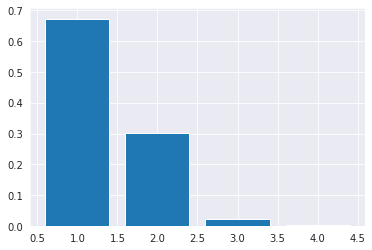

In [ ]:
dataloc = np.asarray(bb)
m = np.mean(dataloc, axis =0)
center = dataloc-m
cov = np.cov(center.T)
eigval, eigvect = np.linalg.eig(cov)
i= np.argsort(eigval)[::-1]
eigenvect = eigvect[:,i]
eigvals= eigval[i]
PCON1 = np.dot(dataloc,eigenvect.T[0])
PCON2 = np.dot(dataloc,eigenvect.T[1])
bound = pd.DataFrame(PCON1, columns=['p1'])
bound['p2'] = PCON2
exp_var =eigvals/sum(eigvals)
print(exp_var)
#plot % of variance explained
plt.bar(range(1,5),exp_var)

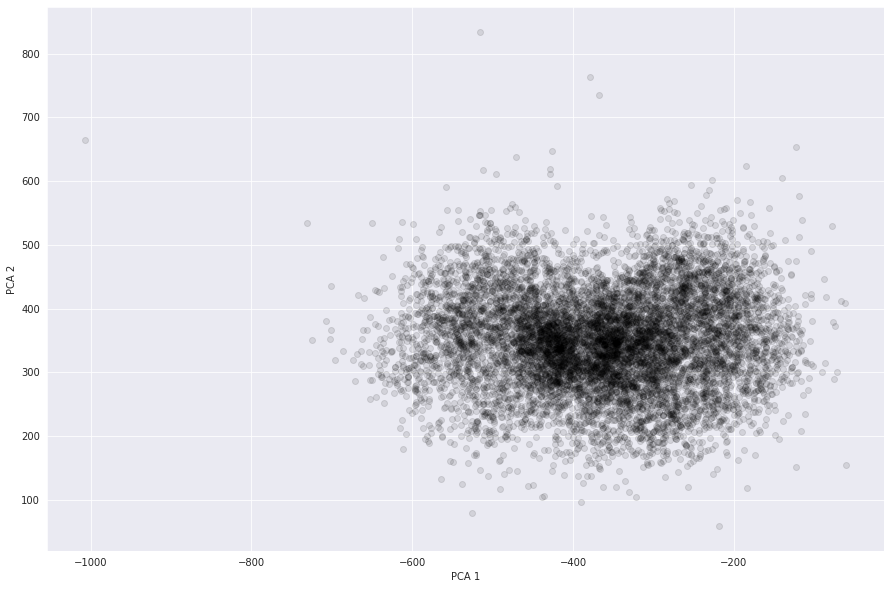

In [ ]:
 #plot first 2 components
plt.scatter(bound['p1'],bound['p2'], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

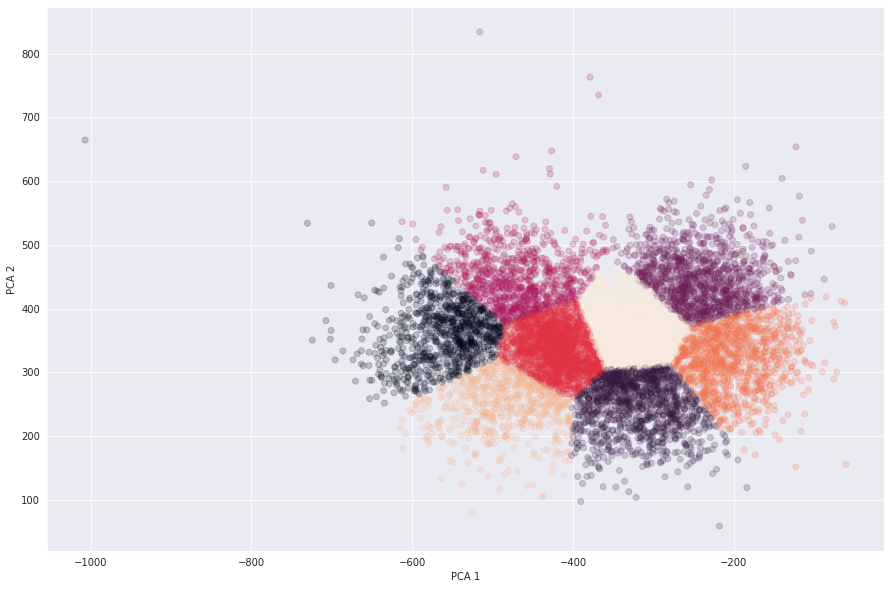

In [ ]:
kmeans = KMeans(n_clusters=8,algorithm='full').fit(bound.iloc[:,:2])
plt.scatter(bound['p1'], bound['p2'], alpha=.2, c=kmeans.labels_)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

[0.96020879 0.03979121]


<BarContainer object of 2 artists>

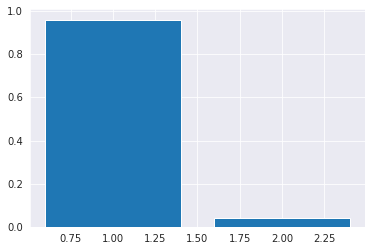

In [ ]:
dataloc = np.asarray(di)
m = np.mean(dataloc, axis =0)
center = dataloc-m
cov = np.cov(center.T)
eigval, eigvect = np.linalg.eig(cov)
i= np.argsort(eigval)[::-1]
eigenvect = eigvect[:,i]
eigvals= eigval[i]
PCON1 = np.dot(dataloc,eigenvect.T[0])
PCON2 = np.dot(dataloc,eigenvect.T[1])
diam = pd.DataFrame(PCON1, columns=['p1'])
diam['p2'] = PCON2
exp_var =eigvals/sum(eigvals)
print(exp_var)
#plot % of variance explained
plt.bar(range(1,3),exp_var)

Text(0, 0.5, 'PCA 2')

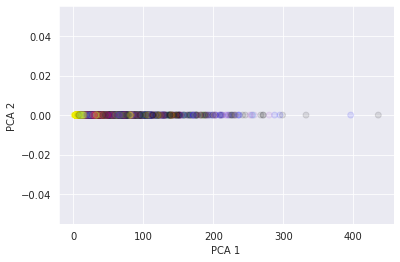

In [ ]:
#plot 1 dimension
plt.scatter(diam['p1'],[0] * len(res), alpha=.1, color=coltype)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2') 


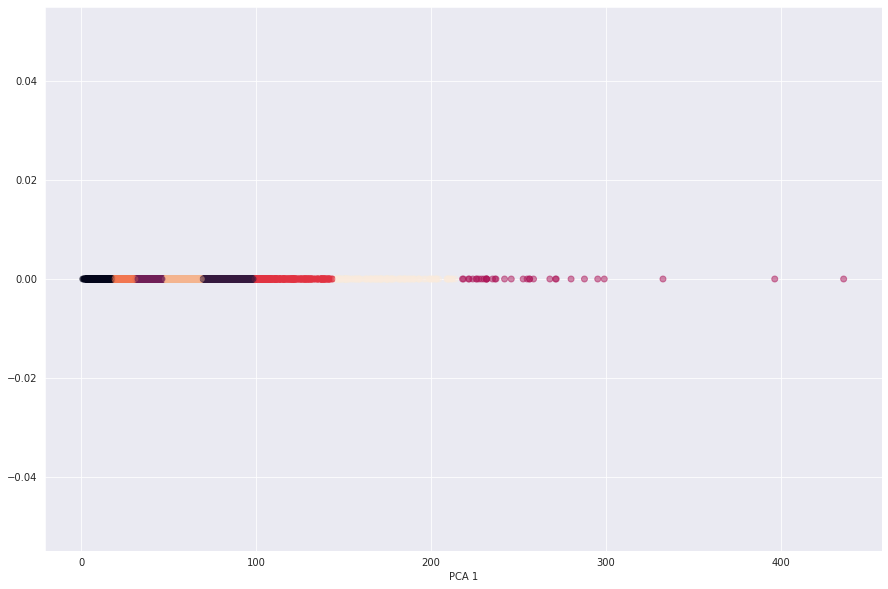

In [ ]:
kmeans = KMeans(n_clusters=8,algorithm='full').fit(diam.iloc[:,:1])
plt.scatter(diam['p1'], [0] * len(res), alpha=.5, c=kmeans.labels_)
plt.xlabel('PCA 1')
plt.gcf().set_size_inches((15,10))

[6.68053693e-01 2.99714508e-01 1.16223759e-02 9.23001419e-03
 5.53482349e-03 4.64459141e-03 8.45770449e-04 3.54224225e-04]


<BarContainer object of 8 artists>

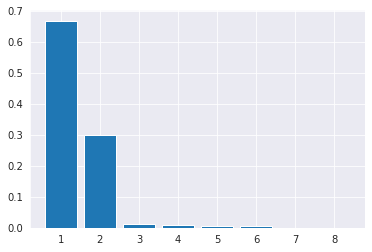

In [ ]:
dataloc = np.asarray(mc)
m = np.mean(dataloc, axis =0)
center = dataloc-m
cov = np.cov(center.T)
eigval, eigvect = np.linalg.eig(cov)
i= np.argsort(eigval)[::-1]
eigenvect = eigvect[:,i]
eigvals= eigval[i]
PCON1 = np.dot(dataloc,eigenvect.T[0])
PCON2 = np.dot(dataloc,eigenvect.T[1])
meas = pd.DataFrame(PCON1, columns=['p1'])
meas['p2'] = PCON2
exp_var =eigvals/sum(eigvals)
print(exp_var)
#plot % of variance explained
plt.bar(range(1,9),exp_var)

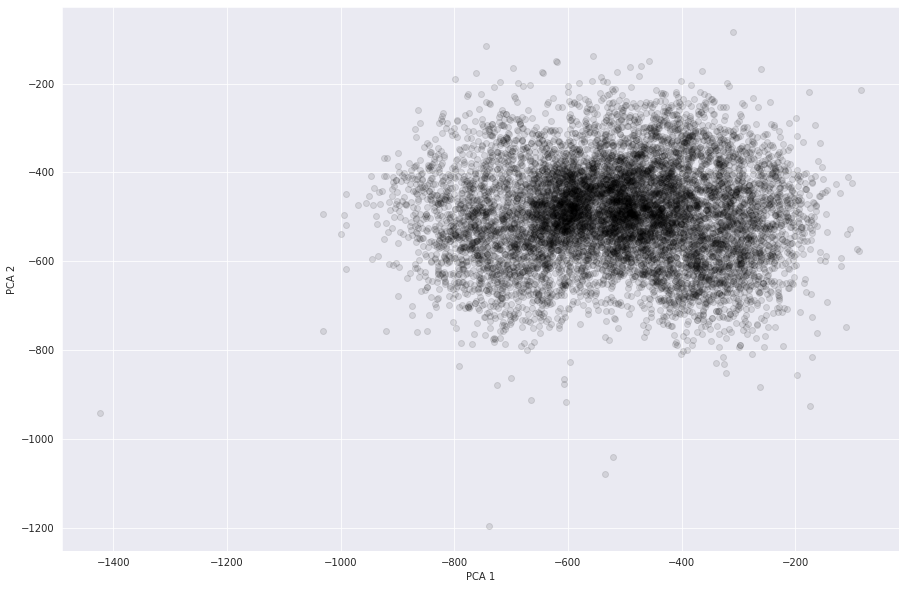

In [ ]:
#plot first 2 components
plt.scatter(meas['p1'],meas['p2'], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

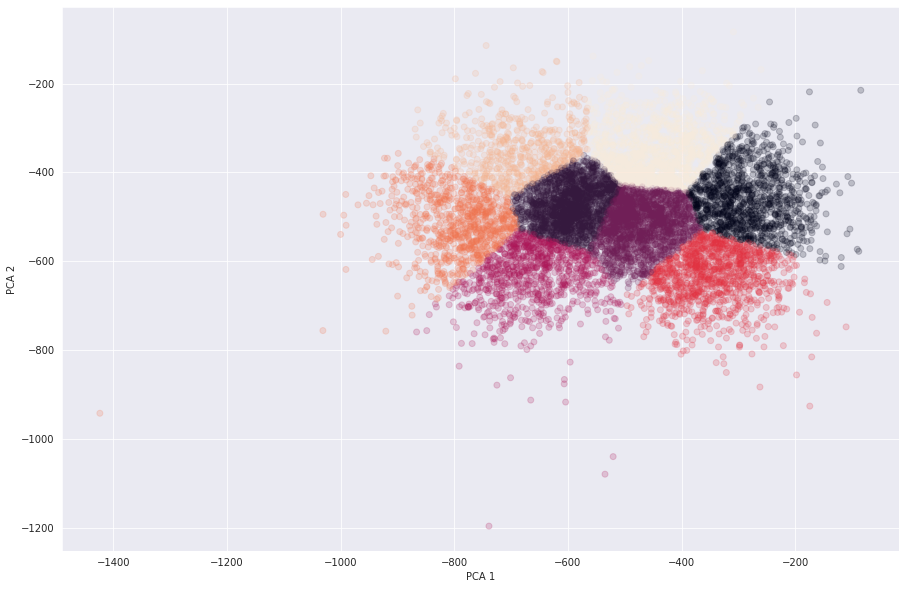

In [ ]:
kmeans = KMeans(n_clusters=8,algorithm='full').fit(meas.iloc[:,:2])
plt.scatter(meas['p1'], meas['p2'], alpha=.2, c=kmeans.labels_)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

[0.47338673 0.27049025 0.25612302]


<BarContainer object of 3 artists>

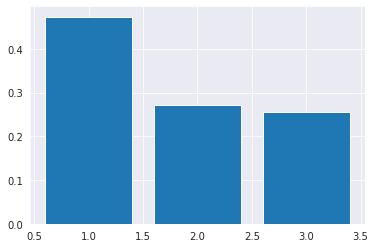

In [ ]:
dataloc = np.asarray(nll)
m = np.mean(dataloc, axis =0)
center = dataloc-m
cov = np.cov(center.T)
eigval, eigvect = np.linalg.eig(cov)
i= np.argsort(eigval)[::-1]
eigenvect = eigvect[:,i]
eigvals= eigval[i]
PCON1 = np.dot(dataloc,eigenvect.T[0])
PCON2 = np.dot(dataloc,eigenvect.T[1])
PCON3 = np.dot(dataloc,eigenvect.T[2])
norm = pd.DataFrame(PCON1, columns=['p1'])
norm['p2'] = PCON2
norm['p3'] = PCON3
exp_var =eigvals/sum(eigvals)
print(exp_var)
#plot % of variance explained
plt.bar(range(1,4),exp_var)

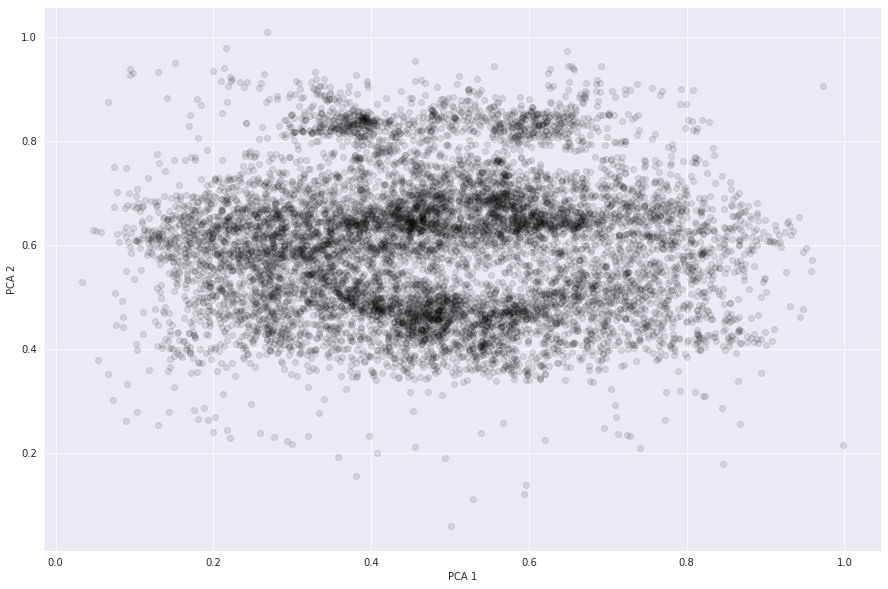

In [ ]:
#plot first 2 components
plt.scatter(norm['p1'],norm['p3'], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

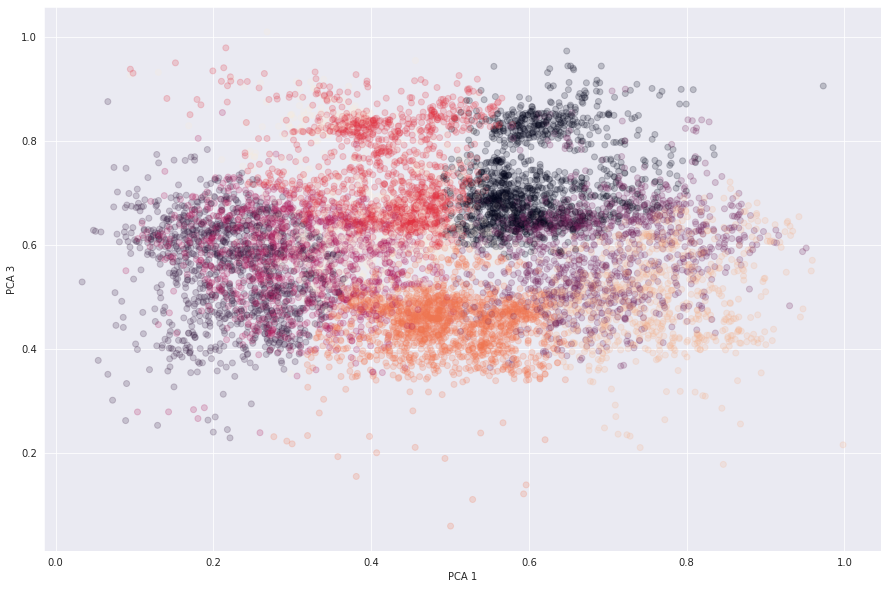

In [ ]:
kmeans = KMeans(n_clusters=8,algorithm='full').fit(norm.iloc[:,:3])
plt.scatter(norm['p1'], norm['p3'], alpha=.2, c=kmeans.labels_)
plt.xlabel('PCA 1')
plt.ylabel('PCA 3')
plt.gcf().set_size_inches((15,10))

[6.58008786e-01 2.95244744e-01 2.40171085e-02 7.61801648e-03
 6.06455794e-03 3.63640496e-03 3.03178446e-03 7.80642843e-04
 5.80917085e-04 5.57693508e-04 2.44781817e-04 1.01587138e-04
 6.58364046e-05 4.67761231e-05 2.78457296e-07 6.93082395e-08
 1.50537748e-08]


<BarContainer object of 17 artists>

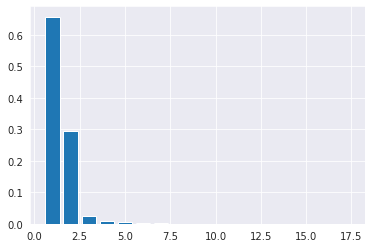

In [ ]:
dataloc = np.asarray(full)
m = np.mean(dataloc, axis =0)
center = dataloc-m
cov = np.cov(center.T)
eigval, eigvect = np.linalg.eig(cov)
i= np.argsort(eigval)[::-1]
eigenvect = eigvect[:,i]
eigvals= eigval[i]
PCON1 = np.dot(dataloc,eigenvect.T[0])
PCON2 = np.dot(dataloc,eigenvect.T[1])
PCON3 = np.dot(dataloc,eigenvect.T[2])
res = pd.DataFrame(PCON1, columns=['p1'])
res['p2'] = PCON2
res['p3'] = PCON3
exp_var =eigvals/sum(eigvals)
print(exp_var)
#plot % of variance explained
plt.bar(range(1,18),exp_var)

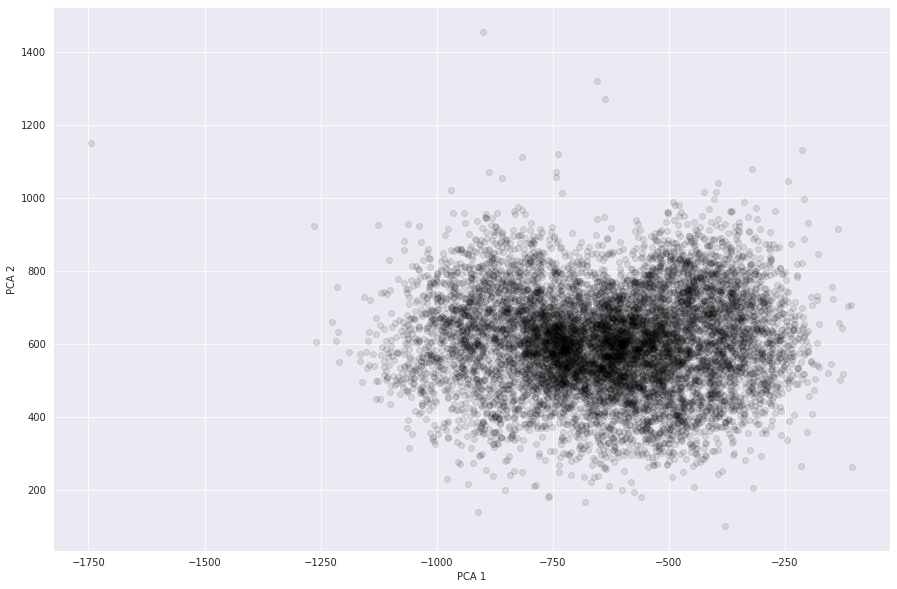

In [ ]:
#plot 1 dimension
plt.scatter(res['p1'],res['p2'], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2') 
plt.gcf().set_size_inches((15,10))

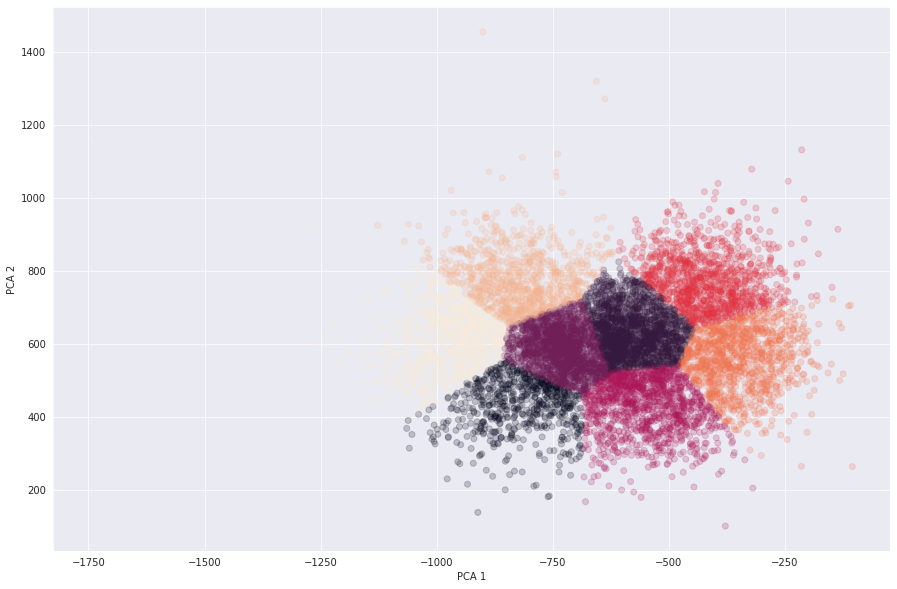

In [ ]:
kmeans = KMeans(n_clusters=8,algorithm='full').fit(res.iloc[:,:3])
plt.scatter(res['p1'], res['p2'], alpha=.2, c=kmeans.labels_)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.gcf().set_size_inches((15,10))

In [ ]:
bound

,p1,p2
0,-335.974576,129.181019
1,-335.917676,407.002852
2,-380.146331,397.594220
3,-373.541107,190.689677
4,-434.178522,295.252874
...,...,...
9811,-384.918835,384.733505
9812,-308.417530,246.038799
9813,-388.819926,429.311799
9814,-266.084387,455.790607


In [ ]:
diam

,p1,p2
0,12.767105,-2.505267
1,16.969906,-3.528626
2,79.581619,5.153919
3,27.666481,-2.343260
4,23.868140,-4.363447
...,...,...
9811,30.724260,-0.583207
9812,32.468347,3.076007
9813,66.189263,4.669076
9814,45.685809,8.716021


In [ ]:
norm

,p1,p2,p3
0,0.449352,-0.253230,0.450280
1,0.444935,-0.457225,0.360992
2,0.507099,-0.471996,0.373712
3,0.500998,-0.245557,0.469598
4,0.581290,-0.386587,0.467409
...,...,...,...
9811,0.521854,-0.468303,0.484706
9812,0.371401,-0.253376,0.904921
9813,0.484029,-0.598698,0.840327
9814,0.345758,-0.614245,0.650223


In [ ]:
meas

,p1,p2
0,-475.299537,-183.339106
1,-473.768365,-576.197550
2,-540.152365,-567.382023
3,-528.802165,-270.592796
4,-615.775091,-418.051582
...,...,...
9811,-543.635315,-544.113479
9812,-432.861406,-350.321122
9813,-542.739358,-605.258344
9814,-373.850356,-647.554160


In [ ]:
lesion_data = pd.read_csv('drive/MyDrive/data_v1_2021.csv')
lesion_train = lesion_data[lesion_data['Coarse_lesion_type'] != -1] 
print(lesion_train.shape)
lesion_data

(9816, 18)


,File_name,Patient_index,Study_index,Series_ID,Key_slice_index,Measurement_coordinates,Bounding_boxes,Lesion_diameters_Pixel_,Normalized_lesion_location,Coarse_lesion_type,Possibly_noisy,Slice_range,Spacing_mm_px_,Image_size,DICOM_windows,Patient_gender,Patient_age,Train_Val_Test
0,000001_01_01_109.png,1,1,1,109,"233.537, 95.0204, 234.057, 106.977, 231.169, 1...","226.169, 90.0204, 241.252, 111.977","11.9677, 5.10387","0.44666, 0.283794, 0.434454",3,0,"103, 115","0.488281, 0.488281, 5","512, 512","-175, 275",F,62.0,3
1,000001_02_01_014.png,1,2,1,14,"224.826, 289.296, 224.016, 305.294, 222.396, 2...","217.396, 284.296, 233.978, 310.294","16.019, 6.61971","0.431015, 0.485238, 0.340745",3,0,"8, 23","0.314453, 0.314453, 5","512, 512","-175, 275",F,72.0,3
2,000001_02_01_017.png,1,2,1,17,"272.323, 320.763, 246.522, 263.371, 234.412, 3...","229.412, 258.371, 285.221, 325.763","62.9245, 48.9929","0.492691, 0.503106, 0.351754",3,0,"8, 23","0.314453, 0.314453, 5","512, 512","-175, 275",F,72.0,3
3,000001_03_01_088.png,1,3,1,88,"257.759, 157.618, 260.018, 133.524, 251.735, 1...","246.735, 128.524, 270.288, 162.618","24.1998, 13.6123","0.498999, 0.278924, 0.452792",3,0,"58, 118","0.732422, 0.732422, 1","512, 512","-175, 275",F,73.0,3
4,000001_04_01_017.png,1,4,1,17,"304.019, 230.585, 292.217, 211.789, 304.456, 2...","287.217, 206.789, 309.456, 235.585","22.1937, 9.8065","0.572678, 0.42336, 0.445674",3,0,"11, 23","0.666016, 0.666016, 5","512, 512","-175, 275",F,73.0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32730,004458_01_01_059.png,4458,1,1,59,"395.737, 284.142, 385.026, 310.221, 402.198, 3...","376.707, 279.142, 407.198, 315.221","28.1937, 22.1522","0.862386, 0.522347, 0.623233",-1,0,"40, 85","0.857422, 0.857422, 5","512, 512","-175, 275",F,66.0,1
32731,004458_01_01_049.png,4458,1,1,49,"411.677, 296.13, 380.941, 321.278, 404.527, 32...","375.941, 291.13, 416.677, 328.028","39.7138, 30.688","0.845748, 0.557232, 0.570726",-1,0,"40, 85","0.857422, 0.857422, 5","512, 512","-175, 275",F,66.0,1
32732,004458_01_01_047.png,4458,1,1,47,"204.055, 307.341, 170.022, 316.047, 180.311, 3...","165.022, 297.592, 209.055, 329.357","35.1289, 22.4662","0.339313, 0.588705, 0.56127",-1,0,"40, 85","0.857422, 0.857422, 5","512, 512","-175, 275",F,66.0,1
32733,004458_01_01_102.png,4458,1,1,102,"276.457, 361.216, 220.572, 354.23, 247.117, 35...","215.572, 347.367, 281.457, 373.201","56.3199, 15.9573","0.477197, 0.730823, 0.813426",-1,0,"96, 108","0.857422, 0.857422, 5","512, 512","-175, 275",F,66.0,1


In [ ]:
###Feature Scaling of lesion_train###
sc = MinMaxScaler()
lesion_train_type = lesion_train[['Coarse_lesion_type']]
lesion_pca_train = pd.DataFrame.copy(lesion_train[['Normalized_lesion_location','Lesion_diameters_Pixel_']])

for i in range(3):
    lesion_pca_train['Normalized_lesion_location{}'.format(i+1)] = lesion_pca_train.Normalized_lesion_location.str.split(', ',expand=True)[i]
for i in range(2):
    lesion_pca_train['Lesion_diameters_Pixel_{}'.format(i+1)] = lesion_pca_train.Lesion_diameters_Pixel_.str.split(', ',expand=True)[i]

lesion_pca_train.drop(columns = ['Normalized_lesion_location','Lesion_diameters_Pixel_'], inplace=True)

for columns in lesion_pca_train:
    lesion_pca_train[columns] = lesion_pca_train[columns].astype(float)

lesion_np_train = sc.fit_transform(lesion_pca_train)    

lesion_np_train

array([[0.44639014, 0.20141251, 0.41151473, 0.02888107, 0.02272755],
       [0.43002236, 0.42602758, 0.31400477, 0.03925655, 0.03033537],
       [0.49454773, 0.44595084, 0.32546031, 0.15938278, 0.24300144],
       ...,
       [0.47465426, 0.59802685, 0.80834318, 0.13171294, 0.20320973],
       [0.32524238, 0.60339681, 0.61344605, 0.08245697, 0.16216982],
       [0.08887148, 0.63825695, 0.6522465 , 0.08735263, 0.15235841]])

In [ ]:
print("lesion_np_train shape:", lesion_np_train.shape, type(lesion_np_train))

lesion_np_train shape: (9816, 5) <class 'numpy.ndarray'>


### Auto Encoders

In [ ]:
###AUTOENCODER###
#input placeholder for autoencoder (dimensions of incoming input)
input_dim = keras.Input(shape=(5,))
encoding_dim = 2

#encode the input
enc = keras.layers.Dense(10, activation='relu')(input_dim)
enc = keras.layers.Dense(5, activation='relu')(enc)
enc = keras.layers.Dense(encoding_dim, activation='relu', activity_regularizer=keras.regularizers.l1(10e-6))(enc)

#decode the encoded input
dec = keras.layers.Dense(5, activation='relu', activity_regularizer=keras.regularizers.l1(10e-6))(enc)
dec = keras.layers.Dense(10, activation='relu')(dec)
dec = keras.layers.Dense(5, activation=None)(dec)

#create a model that maps the input to its reconstruction
autoencoder = keras.Model(inputs=input_dim, outputs=dec)

#we also create an encoder that allows us to view the reduced components
encoder = keras.Model(inputs=input_dim, outputs=enc)

#compile the autoencoder, using mean squared error since some of our data is not normalized
autoencoder.compile(optimizer = keras.optimizers.SGD(learning_rate=0.1), loss = 'mse')

#we now fit the autoencoder to our data
model = autoencoder.fit(lesion_np_train, lesion_np_train, epochs=100, batch_size=32, shuffle=False, verbose=0)


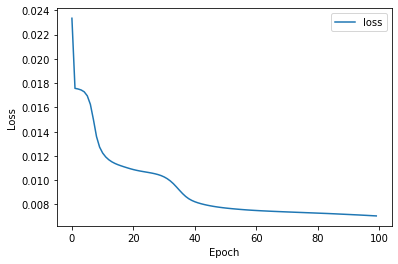

In [ ]:
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.plot(range(len(model.history['loss'])), model.history['loss'], label='loss')
plt.legend()
plt.show()

In [ ]:
encoded_train_lesion = encoder.predict(lesion_np_train)
decoded_train_lesion = autoencoder.predict(lesion_np_train)

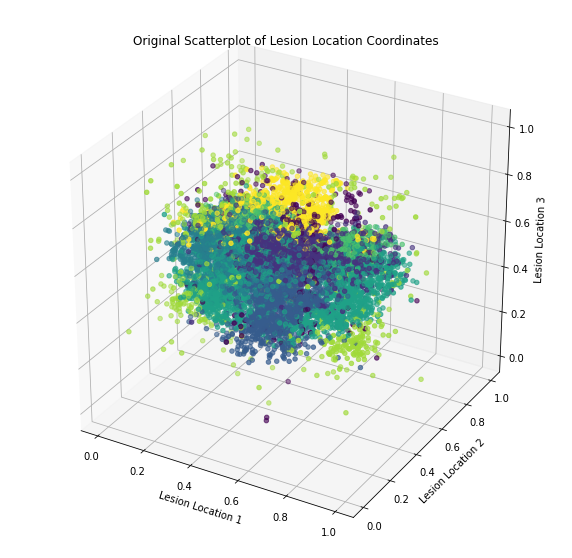

In [ ]:
fig = plt.figure(figsize=(10,10))
axs = fig.add_subplot(111, projection = '3d')
axs.set_xlabel('Lesion Location 1')
axs.set_ylabel('Lesion Location 2')
axs.set_zlabel('Lesion Location 3')
axs.set_title('Original Scatterplot of Lesion Location Coordinates')
axs.scatter3D(lesion_np_train[:,0], lesion_np_train[:,1], lesion_np_train[:,2], c=lesion_train_type.to_numpy(), marker='o')
plt.show()

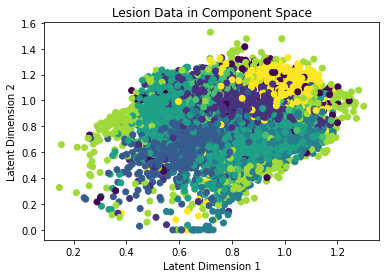

In [ ]:
plt.xlabel('Latent Dimension 1')
plt.ylabel('Latent Dimension 2')
plt.title('Lesion Data in Component Space')
plt.scatter(encoded_train_lesion[:,0], encoded_train_lesion[:,1], c=lesion_train_type.to_numpy(), marker='o')
plt.show()

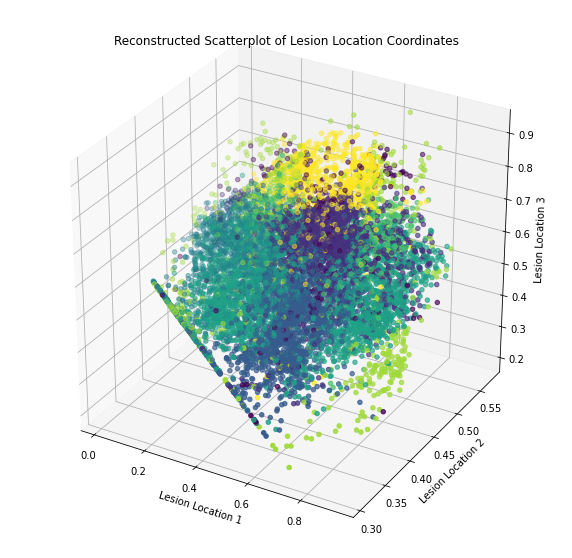

In [ ]:
fig = plt.figure(figsize=(10,10))
axs = fig.add_subplot(111, projection = '3d')
axs.set_xlabel('Lesion Location 1')
axs.set_ylabel('Lesion Location 2')
axs.set_zlabel('Lesion Location 3')
axs.set_title('Reconstructed Scatterplot of Lesion Location Coordinates')
axs.scatter3D(decoded_train_lesion[:,0], decoded_train_lesion[:,1], decoded_train_lesion[:,2], c=lesion_train_type.to_numpy(), marker='o')
plt.show()